In [1]:
# for making plots pretty
%matplotlib inline
%config InlineBackend.figure_format = 'retina'  # 'svg' is also a good option

import matplotlib.pyplot as plt

# Set the font scale and the general figure size for your plots
plt.rcParams.update({'font.size': 12, 'figure.figsize': (6, 5)})
# plt.style.use(['seaborn-v0_8'])
# Set default colormap
plt.set_cmap('viridis')

<Figure size 600x500 with 0 Axes>

# Radar Image Extraction/Visualization

### Generate gifs from every nth frame in a sequence


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import imageio
from glob import glob
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm

# Directory of your files
path = '/home/ubuntu/data/modelOut/'
folder = 'TGCLTG_v2Mask_Iter12'
data_dir = path+folder

# Collect all npz files
npz_files = glob(os.path.join(data_dir, '*.npz'))

# Group files by date and type
data_dict = {}
for npz_file in npz_files:
    base_name = os.path.basename(npz_file)
    date, data_type, _ = base_name.split('_')

    if date not in data_dict:
        data_dict[date] = {}

    data_dict[date][data_type] = npz_file

# Process each date
for date, data_types in data_dict.items():
    # Ensure we have 'gt' and 'pred' for this date
    if 'gt' not in data_types or 'pred' not in data_types:
        print(f"Missing 'gt' or 'pred' data for date {date}, skipping...")
        continue

    # Load data
    gt_data = np.load(data_types['gt'])
    pred_data = np.load(data_types['pred'])

    # Make sure we have the same keys in both 'gt' and 'pred'
    common_keys = set(gt_data.files) & set(pred_data.files)


    # for debugging, run for n number of frames:
    nframes = 30
    
    frameNo = [1,7,10,15]
    
    for step in frameNo:
        
        # clear 'images' so we start with a fresh GIF
        images = []
        
        for key in gt_data.files:
            
            gt_seq = gt_data[key][step,:,:]  # load the entire sequence
            pred_seq = pred_data[key][step,:,:]  # load the entire sequence

            fig, axs = plt.subplots(1, 2, figsize=(10, 5))

            # Ground truth on the left
            axs[0].imshow(gt_seq, cmap='jet')
            axs[0].axis('off')
            axs[0].set_title('Ground Truth')

            # Prediction on the right
            axs[1].imshow(pred_seq, cmap='jet')
            axs[1].axis('off')
            axs[1].set_title('Prediction')
            
            # Remove white space
            plt.tight_layout()

            # Convert plot to RGB array
            fig.canvas.draw()
            image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
            image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

            images.append(image)

            plt.close(fig)
            if i > nframes+1:
                break
            

        # Save images as gif
        gif_filepath = os.path.join(path,'GIFs', f'{date}_{step}thFrame_{folder}.gif')
        imageio.mimsave(gif_filepath, images, duration=0.1)

        print(f"Saved gif: {gif_filepath}")


### Generate gifs of 25 images in a sequence
Observations: ConvGRU_3x for iter = 9 doesn't capture any of data
TrajGRU_3x iter = 9 starts to capture some trends
pixellation shows incomplete training 


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import imageio
from glob import glob
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm

# Directory of your files
path = '/home/ubuntu/data/modelOut/'
folder = 'TGCLTG_v2Mask_Iter12'
data_dir = path+folder

# Collect all npz files
npz_files = glob(os.path.join(data_dir, '*.npz'))

# Group files by date and type
data_dict = {}
for npz_file in npz_files:
    base_name = os.path.basename(npz_file)
    date, data_type, _ = base_name.split('_')

    if date not in data_dict:
        data_dict[date] = {}

    data_dict[date][data_type] = npz_file

# Process each date
for date, data_types in data_dict.items():
    # Ensure we have 'gt' and 'pred' for this date
    if 'gt' not in data_types or 'pred' not in data_types:
        print(f"Missing 'gt' or 'pred' data for date {date}, skipping...")
        continue

    # Load data
    gt_data = np.load(data_types['gt'])
    pred_data = np.load(data_types['pred'])

    # Make sure we have the same keys in both 'gt' and 'pred'
    common_keys = set(gt_data.files) & set(pred_data.files)

    image = []
    images = []    

    # start looking at data starting from step 180, which corresponds to a particularly animated sequence for 3/4/17
    key  = gt_data.files[180]
        
    for step in range(20):
        gt_seq = gt_data[key][step,:,:]  # load the entire sequence
        pred_seq = pred_data[key][step,:,:]  # load the entire sequence

        fig, axs = plt.subplots(1, 2, figsize=(10, 5))

        # Ground truth on the left
        axs[0].imshow(gt_seq, cmap='jet')
        axs[0].axis('off')
        axs[0].set_title('Ground Truth')

        # Prediction on the right
        axs[1].imshow(pred_seq, cmap='jet')
        axs[1].axis('off')
        axs[1].set_title('Prediction')
        
        # Remove white space
        plt.tight_layout()

        # Convert plot to RGB array
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

        images.append(image)

        plt.close(fig)
        if i > nframes+1:
            break
    

    # Save images as gif
    gif_filepath = os.path.join(path,'GIFs', f'{date}_allFrames_{folder}.gif')
    imageio.mimsave(gif_filepath, images, duration=0.1)

    print(f"Saved gif: {gif_filepath}")


### Generate GIFs of all sequences for different iterations in one image


In [105]:
import os
import numpy as np
import matplotlib.pyplot as plt
import imageio

# Specify npz file path
npz_file = '/home/ubuntu/data/modelOut/TGCLTG_v2Mask_Iter20/201703040020_pred_264.npz'

# Load the npz file
data = np.load(npz_file)

# List to store frames for the GIF
images = []

# Loop through each frame in the npz file
for key in data.files[100:]:
    # Load the frame
    frame = data[key][5,:,:]

    # Create the plot
    fig, ax = plt.subplots(figsize=(5, 5))
    ax.imshow(frame, cmap='jet')
    ax.set_title(f'Frame {key}')
    ax.axis('off')

    # Convert the plot to an image
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    # Add the image to the list of images
    images.append(image)

    # Close the plot to free memory
    plt.close(fig)

# Save the images as a GIF
gif_filepath = '/home/ubuntu/data/modelOut/GIFs/TGCLTG_epoch20.gif'
imageio.mimsave(gif_filepath, images, duration=0.1)

print(f'Saved gif: {gif_filepath}')


Saved gif: /home/ubuntu/data/modelOut/GIFs/TGCLTG_epoch20.gif


In [83]:
# explore the file npz file to figure out frame numbers of interest

import os
import numpy as np
import matplotlib.pyplot as plt
import imageio
from glob import glob
import re

# Directory of your files
path = '/home/ubuntu/data/modelOut/'
folder = 'TGCLTG_iterCycle'
data_dir = path+folder

# file names
npzName = '20170304*.npz'

# Collect all npz files
npz_files = glob(os.path.join(data_dir, npzName))

images = []

radarData = np.load(npz_files[1])

for key in radarData.keys(): print(key)

    

    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    # Ground truth on the left
    axs[0].imshow(gt_seq, cmap='jet')
    axs[0].axis('off')
    axs[0].set_title('Ground Truth')

    
    # Remove white space
    plt.tight_layout()

    # Convert plot to RGB array
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    images.append(image)

    plt.close(fig)
    

# Save images as gif
gif_filepath = os.path.join(data_dir, f'20170304Sequence.gif')
imageio.mimsave(gif_filepath, images, duration=0.1)

print(f"Saved gif: {gif_filepath}")

In [107]:
import os
import numpy as np
import matplotlib.pyplot as plt
import imageio
from glob import glob
import re

# Directory of your files
path = '/home/ubuntu/data/modelOut/'
folder = 'TGCLTG_iterCycle'
data_dir = path+folder

# file names
npzName = '20170304*.npz'

# Collect all npz files
npz_files = glob(os.path.join(data_dir, npzName))

# Group files by date and type
data_dict = {}
for npz_file in npz_files:
    base_name = os.path.basename(npz_file)
    date, data_type, epoch_num, _ = base_name.split('_')

    if date not in data_dict:
        data_dict[date] = {}

    if data_type not in data_dict[date]:
        data_dict[date][data_type] = []

    data_dict[date][data_type].append(npz_file)

# Process each date
for date, data_types in data_dict.items():
    # Ensure we have 'gt' for this date
    if 'gt' not in data_types or len(data_types['pred']) == 0:
        print(f"Missing 'gt' or 'pred' data for date {date}, skipping...")
        continue

    # Load ground truth data
    gt_data = np.load(data_types['gt'][0])

    frameNo = [1,7,10,15]
    # frameNo = [1]

    for step in frameNo:
        # clear 'images' so we start with a fresh GIF
        images = []

        for key in gt_data.files[100:]:
            gt_seq = gt_data[key][step,:,:]  # load the ground truth sequence
            
            fig, axs = plt.subplots(2, 3, figsize=(15, 10))

            # Ground truth on the top left
            axs[0, 0].imshow(gt_seq, cmap='jet')
            axs[0, 0].axis('off')
            axs[0, 0].set_title('Ground Truth')
            
            # For the other plots, hide axes and labels
            for ax in axs.flat:
                ax.axis('off')

            # Load prediction data
            for i, pred_file in enumerate(sorted(data_types['pred'], key=lambda s: int(re.findall(r"Epoch(\d+)", s)[0]))):
                pred_data = np.load(pred_file)
                pred_seq = pred_data[key][step,:,:]  # load the prediction sequence
                epoch_num = re.findall(r"Epoch(\d+)", pred_file)[0]  # extract epoch number from filename
                
                # Decide position in grid for each prediction
                if i < 2:
                    x = 0
                    y = i+1
                else:
                    x = 1
                    y = i-2

                axs[x, y].imshow(pred_seq, cmap='jet')
                axs[x, y].set_title(f'Prediction Epoch {epoch_num}')
                
            # Remove white space
            plt.tight_layout()

            # Convert plot to RGB array
            fig.canvas.draw()
            image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
            image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

            images.append(image)

            plt.close(fig)
            
        # Save images as gif
        gif_filepath = os.path.join(path,'GIFs', f'{date}_{step}thFrame_{folder}.gif')
        imageio.mimsave(gif_filepath, images, duration=0.1)

        print(f"Saved gif: {gif_filepath}")


Saved gif: /home/ubuntu/data/modelOut/GIFs/201703040020_1thFrame_TGCLTG_iterCycle.gif
Saved gif: /home/ubuntu/data/modelOut/GIFs/201703040020_7thFrame_TGCLTG_iterCycle.gif
Saved gif: /home/ubuntu/data/modelOut/GIFs/201703040020_10thFrame_TGCLTG_iterCycle.gif
Saved gif: /home/ubuntu/data/modelOut/GIFs/201703040020_15thFrame_TGCLTG_iterCycle.gif


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import imageio
from glob import glob
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm

# Directory of your files
path = '/home/ubuntu/data/modelOut/'
folder = 'convGRU_3x_v2Mask_Iter9'
data_dir = path+folder

# Collect all npz files
npz_files = glob(os.path.join(data_dir, '*.npz'))

# Group files by date and type
data_dict = {}
for npz_file in npz_files:
    base_name = os.path.basename(npz_file)
    date, data_type, _ = base_name.split('_')

    if date not in data_dict:
        data_dict[date] = {}

    data_dict[date][data_type] = npz_file

# Process each date
for date, data_types in data_dict.items():
    # Ensure we have 'gt' and 'pred' for this date
    if 'gt' not in data_types or 'pred' not in data_types:
        print(f"Missing 'gt' or 'pred' data for date {date}, skipping...")
        continue

    # Load data
    gt_data = np.load(data_types['gt'])
    pred_data = np.load(data_types['pred'])

    # Make sure we have the same keys in both 'gt' and 'pred'
    common_keys = set(gt_data.files) & set(pred_data.files)

    images = []
    # for debugging, run for n number of frames:
    nframes = 30
    
    frameNo = [1]
    
    for step in frameNo:
            
        for key in gt_data.files:
            
            gt_seq = gt_data[key][step,:,:]  # load the entire sequence
            pred_seq = pred_data[key][step,:,:]  # load the entire sequence

            fig, axs = plt.subplots(1, 2, figsize=(10, 5))

            # Ground truth on the left
            axs[0].imshow(gt_seq, cmap='jet')
            axs[0].axis('off')
            axs[0].set_title('Ground Truth')

            # Prediction on the right
            axs[1].imshow(pred_seq, cmap='jet')
            axs[1].axis('off')
            axs[1].set_title('Prediction')
            
            # Remove white space
            plt.tight_layout()

            # Convert plot to RGB array
            fig.canvas.draw()
            image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
            image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

            images.append(image)

            plt.close(fig)
            if i > nframes+1:
                break
            

        # Save images as gif
        gif_filepath = os.path.join(data_dir, f'{date}_{step}thFrame_{folder}.gif')
        imageio.mimsave(gif_filepath, images, duration=0.1)

        print(f"Saved gif: {gif_filepath}")


### Plot average pixel intensities for each timestep

In [ ]:
# plot average pixel intensities for each timestep, to narrow down the window of visualization
import os
import numpy as np
import matplotlib.pyplot as plt
from glob import glob

# Directory of your files
path = '/home/ubuntu/data/modelOut/'
folder = 'TGTGTG_v2Mask_Iter22'
data_dir = path + folder

# frame number to analyze:
step = 7

# Small constant to avoid log(0)
eps = 1e-10

# Collect all npz files
npz_files = glob(os.path.join(data_dir, '*.npz'))

# Group files by date and type
data_dict = {}
for npz_file in npz_files:
    base_name = os.path.basename(npz_file)
    date, data_type, _ = base_name.split('_')

    if date not in data_dict:
        data_dict[date] = {}

    data_dict[date][data_type] = npz_file

# Process each date
for date, data_types in data_dict.items():
    # Ensure we have 'gt' and 'pred' for this date
    if 'gt' not in data_types or 'pred' not in data_types:
        print(f"Missing 'gt' or 'pred' data for date {date}, skipping...")
        continue

    # Load data
    gt_data = np.load(data_types['gt'])
    pred_data = np.load(data_types['pred'])

    # Make sure we have the same keys in both 'gt' and 'pred'
    common_keys = set(gt_data.files) & set(pred_data.files)

    # Initialize lists to hold average intensities
    gt_avg_intensities = []
    pred_avg_intensities = []
    
    for key in common_keys:
        gt_seq = gt_data[key]
        pred_seq = pred_data[key]
        
        # Calculate average pixel intensity for each time step
        gt_avg_intensities.append(np.nanmean(np.log(gt_seq[step] + eps)))
        pred_avg_intensities.append(np.nanmean(np.log(pred_seq[step] + eps)))


    # Plotting
    plt.figure(figsize=(10, 5))
    plt.plot(gt_avg_intensities, label='Ground Truth')
    plt.plot(pred_avg_intensities, label='Prediction')
    plt.xlabel('Time Step')
    plt.ylabel('Average Pixel Intensity')
    plt.title(f"Average Pixel Intensity vs. Time Step for {date}")
    plt.legend()
    plt.show()


### Data files description:
Within each npz file, you have sets of predictions/ground truths that are indexed by time

In [ ]:
#%% Explore hdf_archives dataset
import numpy as np
import pandas as pd
import tensorflow as tf
import h5py
import matplotlib.pyplot as plt

path = r'/Users/alexyoung/cs230/dlProjects/TAASRAD19/hdf_archives/'

# open hdf file
f1 = h5py.File(path+'20101101.hdf5','r')

# for this specific sequence, has two keys: '0' and '1' (both strings). Still not sure the difference between the two
# shape is [164,480,480] and [122,480,480]. I'm guessing first index is frame number, each frame is 480x480
x0 = tf.data.Dataset.from_tensor_slices(f1['0'])
x1 = tf.data.Dataset.from_tensor_slices(f1['1'])

images_iter = iter(x0)
images1_iter = iter(x1)

plt.imshow(next(images1_iter).numpy())

## Still Image Generation

### Generate series of images showing frames within a prediction, ordered in a single row
Also, generate images of different model iterations/epochs

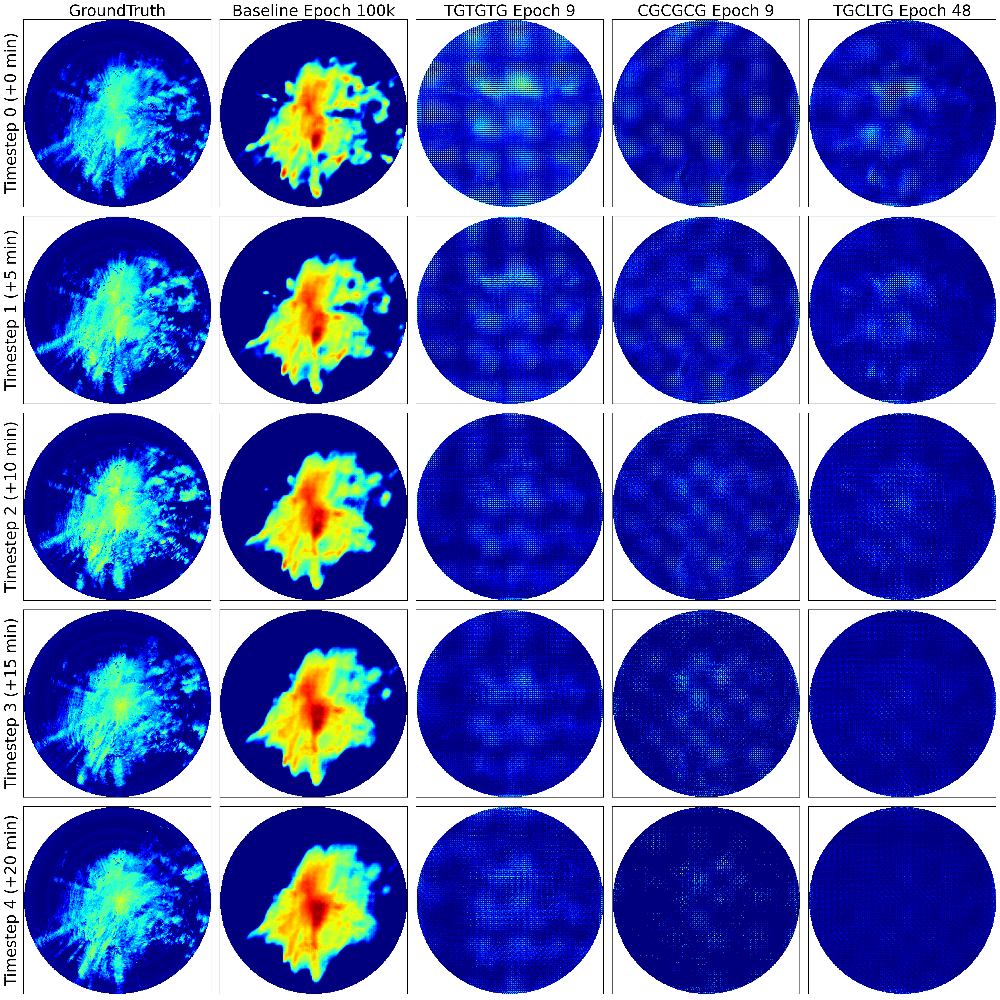

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
from glob import glob

# Directory of your files
data_dir = '/home/ubuntu/data/modelOut/summaryImg'
files = sorted(glob(os.path.join(data_dir, '*.npz')))

# Define file order and labels
file_order = {
    'GroundTruth.npz': 0,
    'fullyTrainedBaseline.npz': 1,
    'TGTGTG_Epoch9.npz': 2,
    'CGCGCG_Epoch9.npz': 3,
    'TGCLTG_Epoch48.npz': 4
}

file_labels = {
    'GroundTruth.npz': 'GroundTruth',
    'fullyTrainedBaseline.npz': 'Baseline Epoch 100k',
    'TGTGTG_Epoch9.npz': 'TGTGTG Epoch 9',
    'CGCGCG_Epoch9.npz': 'CGCGCG Epoch 9',
    'TGCLTG_Epoch48.npz': 'TGCLTG Epoch 48'
}

# Reorder the files based on the defined order
files = sorted(files, key=lambda f: file_order[os.path.basename(f)])

n_files = len(files)
n_timesteps = 5

fig, axs = plt.subplots(n_timesteps, n_files, figsize=(n_files*5, n_timesteps*5))

for i, file in enumerate(files):
    data = np.load(file)
    key_100 = list(data.keys())[168]  # get the 100th key

    for j in range(n_timesteps):
        ax = axs[j, i]
        ax.imshow(data[key_100][j, :, :], cmap='jet')

        # Remove x and y ticks
        ax.set_xticks([])
        ax.set_yticks([])

        # Add column labels for the first row
        if j == 0:
            ax.set_title(file_labels[os.path.basename(file)], fontsize = 28)

        # Add row labels for the first column
        if i == 0:
            ax.set_ylabel(f'Timestep {j} (+{j*5} min)', rotation=90, fontsize = 28)

plt.tight_layout()
plt.show()

# Analysis of training logs

### MSE, MAE, GDL vs Epochs
Note the errors oscillate. Take a look at the model at iter = 0, 6, 14, 22 to see how the predictions change with time

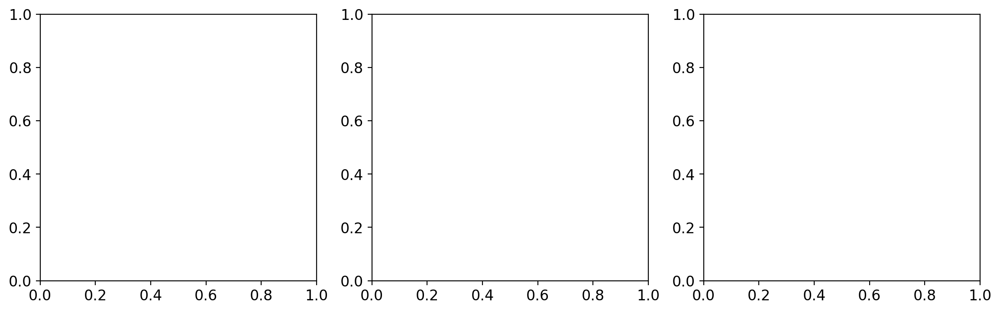

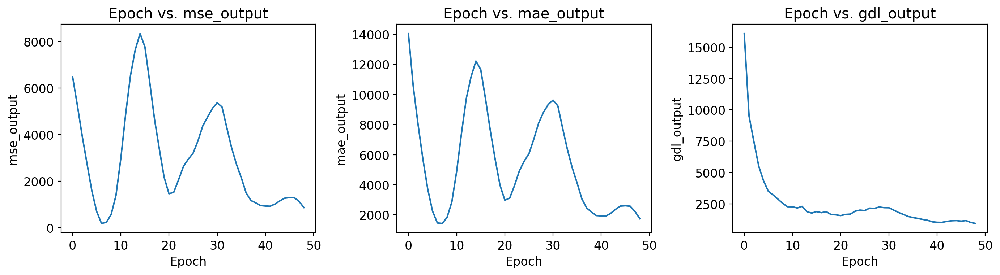

In [99]:
import pandas as pd
import matplotlib.pyplot as plt
import re
from datetime import datetime

path = '/home/ubuntu/gitrepo/CS230_Nowcasting/deep_learning_nowcasting/trainOutput/trainingLogs/'


##### User-defined Settings #####


# Plot iter vs. the other columns
# columns = ['mse_output', 'mae_output', 'gdl_output', 'e_gnorm', 'f_gnorm']
columns = ['mse_output', 'mae_output', 'gdl_output']
# columns = ['e_gnorm', 'f_gnorm']

# Plot all files
# Get all log files in the directory

plural = 1
log_files = [file for file in os.listdir(path) if file.endswith('.log')]
# plot single log file
# Define the log file name
log_file = 'TGCLTG_v2Mask_2.log'


fig, axs = plt.subplots(ncols=len(columns), figsize=(14,4))


# Read the log file
with open(path + log_file, 'r') as f:
    lines = f.readlines()


# Initialize lists to store the data
iters = []
times = []
mse_outputs = []
mae_outputs = []
gdl_outputs = []
e_gnorms = []
f_gnorms = []

# Parse the log file
for line in lines:
    if 'Iter:' in line:
        # Extract the data
        time = re.search(r'\d{4}-\d{2}-\d{2} \d{2}:\d{2}:\d{2}', line).group()
        iter = int(re.search(r'Iter:(\d+)', line).group(1))
        mse_output = float(re.search(r'mse_output=(\d+.\d+)', line).group(1))
        mae_output = float(re.search(r'mae_output=(\d+.\d+)', line).group(1))
        gdl_output = float(re.search(r'gdl_output=(\d+.\d+)', line).group(1))
        e_gnorm = float(re.search(r'e_gnorm=(\d+.\d+)', line).group(1))
        f_gnorm = float(re.search(r'f_gnorm=(\d+.\d+)', line).group(1))

        # Add the data to the lists
        times.append(time)
        iters.append(iter)
        mse_outputs.append(mse_output)
        mae_outputs.append(mae_output)
        gdl_outputs.append(gdl_output)
        e_gnorms.append(e_gnorm)
        f_gnorms.append(f_gnorm)

# Create a DataFrame from the lists
df = pd.DataFrame({
    'iter': iters,
    'time': times,
    'mse_output': mse_outputs,
    'mae_output': mae_outputs,
    'gdl_output': gdl_outputs,
    'e_gnorm': e_gnorms,
    'f_gnorm': f_gnorms
})

# Convert the 'time' column to datetime format
df['time'] = pd.to_datetime(df['time'])

# Calculate the time elapsed from the first iteration
df['time_elapsed'] = df['time'].diff()


fig, axs = plt.subplots(ncols=len(columns), figsize=(14,4))
# fig.suptitle(f"Test Loss: {log_file.split('.')[0]}", fontsize=15)

for i, column in enumerate(columns):
    axs[i].plot(df['iter'], df[column])
    axs[i].set(xlabel='Epoch', ylabel=column)
    axs[i].set_title(f'Epoch vs. {column}')

plt.tight_layout()
# plt.subplots_adjust(top=0.95)

plt.show()



### Plot dots on epoch #'s of interest

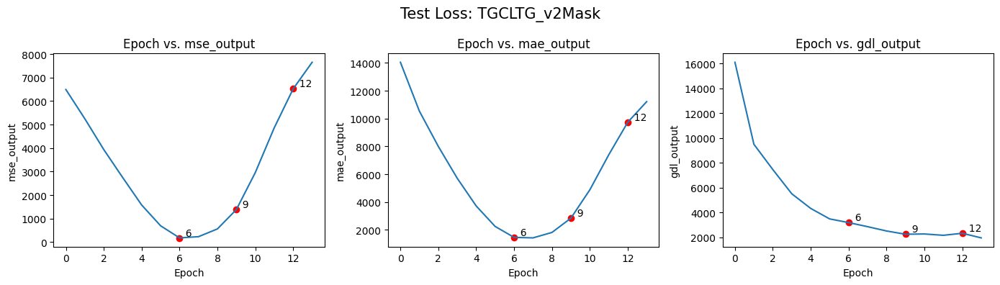

In [70]:
import numpy as np

# Define the epochs you're interested in
epochs = [6, 9, 12]

# Get the corresponding values for each epoch
epoch_values = df[df['iter'].isin(epochs)]

# Plot iter vs. the other columns
columns = ['mse_output', 'mae_output', 'gdl_output']
fig, axs = plt.subplots(ncols=len(columns), figsize=(14,4))
fig.suptitle(f"Test Loss: {log_file.split('.')[0]}", fontsize=15)

for i, column in enumerate(columns):
    axs[i].plot(df['iter'], df[column])
    axs[i].scatter(epoch_values['iter'], epoch_values[column], color='red')  # plot the points
    for x, y in zip(epoch_values['iter'], epoch_values[column]):  # add annotations for each point
        axs[i].text(x, y, f'  {x}', verticalalignment='bottom')
    axs[i].set(xlabel='Epoch', ylabel=column)
    axs[i].set_title(f'Epoch vs. {column}')

plt.tight_layout()
plt.show()


### Plot test losses/norms vs epoch for all conditions in trainingLogs (only up to iter = 9)

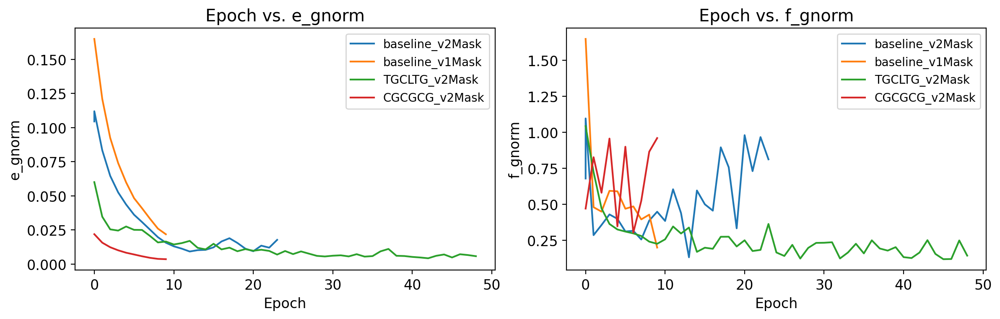

In [103]:
import pandas as pd
import matplotlib.pyplot as plt
import re
from datetime import datetime
import os

path = '/home/ubuntu/gitrepo/CS230_Nowcasting/deep_learning_nowcasting/trainOutput/trainingLogs/'

# Get all log files in the directory
log_files = [file for file in os.listdir(path) if file.endswith('.log')]

#max epoch to plot to
maxEpoch = 100

# columns = ['mse_output', 'mae_output', 'gdl_output', 'e_gnorm', 'f_gnorm']
# columns = ['mse_output', 'mae_output', 'gdl_output']
columns = ['e_gnorm', 'f_gnorm']

fig, axs = plt.subplots(ncols=len(columns), figsize=(12,4))

# Loop over each log file
for log_file in log_files:

    # Read the log file
    with open(path + log_file, 'r') as f:
        lines = f.readlines()

    # Initialize lists to store the data
    iters = []
    times = []
    mse_outputs = []
    mae_outputs = []
    gdl_outputs = []
    e_gnorms = []
    f_gnorms = []

    # Parse the log file
    for line in lines:
        if 'Iter:' in line:
            # Extract the data
            time = re.search(r'\d{4}-\d{2}-\d{2} \d{2}:\d{2}:\d{2}', line).group()
            iter = int(re.search(r'Iter:(\d+)', line).group(1))
            mse_output = float(re.search(r'mse_output=(\d+.\d+)', line).group(1))
            mae_output = float(re.search(r'mae_output=(\d+.\d+)', line).group(1))
            gdl_output = float(re.search(r'gdl_output=(\d+.\d+)', line).group(1))
            e_gnorm = float(re.search(r'e_gnorm=(\d+.\d+)', line).group(1))
            f_gnorm = float(re.search(r'f_gnorm=(\d+.\d+)', line).group(1))

            # Add the data to the lists
            times.append(time)
            iters.append(iter)
            mse_outputs.append(mse_output)
            mae_outputs.append(mae_output)
            gdl_outputs.append(gdl_output)
            e_gnorms.append(e_gnorm)
            f_gnorms.append(f_gnorm)

    # Create a DataFrame from the lists
    df = pd.DataFrame({
        'iter': iters,
        'time': times,
        'mse_output': mse_outputs,
        'mae_output': mae_outputs,
        'gdl_output': gdl_outputs,
        'e_gnorm': e_gnorms,
        'f_gnorm': f_gnorms
    })

    # Convert the 'time' column to datetime format
    df['time'] = pd.to_datetime(df['time'])

    # Calculate the time elapsed from the first iteration
    df['time_elapsed'] = df['time'].diff()
    
    # only show iter up to 9
    df = df.drop(df[df.iter > maxEpoch].index)

    # Plot iter vs. the other columns
    for i, column in enumerate(columns):
        axs[i].plot(df['iter'], df[column], label=log_file.split('.')[0])  # Add label to plot
        axs[i].set(xlabel='Epoch', ylabel=column)
        axs[i].set_title(f'Epoch vs. {column}')
        axs[i].legend(fontsize = 10)  # Display legend

plt.tight_layout()
plt.show()


# Metadata Exploration and plotting

## Summary stats for 2010 to 2012, and describe the train/test days
Also, include details about the single rainstorm event in 2017-03-04 we're using for visualization


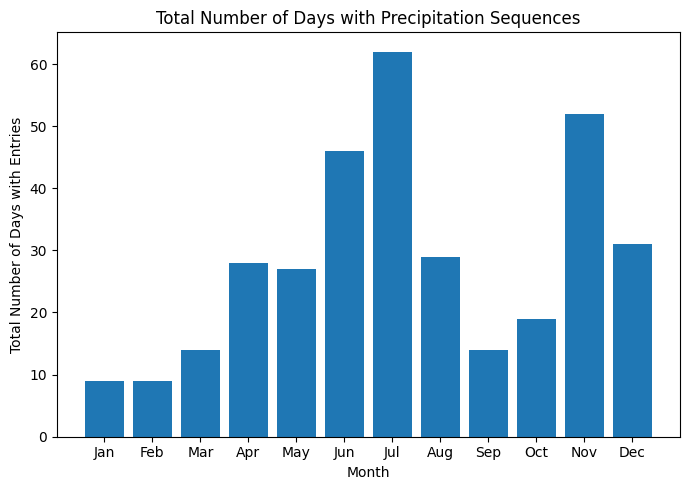

In [59]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV data into a pandas DataFrame
df = pd.read_csv('/home/ubuntu/data/TAASRAD19/hdf_metadata.csv')

# Convert the start_datetime column to datetime
df['start_datetime'] = pd.to_datetime(df['start_datetime'])

# Extract month and day from start_datetime
df['month'] = df['start_datetime'].dt.month
df['day'] = df['start_datetime'].dt.day
df['year'] = df['start_datetime'].dt.year

df = df[(df['year'] >= 2010) & (df['year'] <= 2012)]

# Group by month and day, then count unique days
total_days_per_month = df.groupby('month')['day'].count()

# Plot a histogram
plt.figure(figsize=(7, 5))
plt.bar(total_days_per_month.index, total_days_per_month.values)
plt.xlabel('Month')
plt.ylabel('Total Number of Days with Entries')
plt.title('Total Number of Days with Precipitation Sequences')
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.tight_layout()
plt.show()


### Precip. Tag vs. Month Histogram

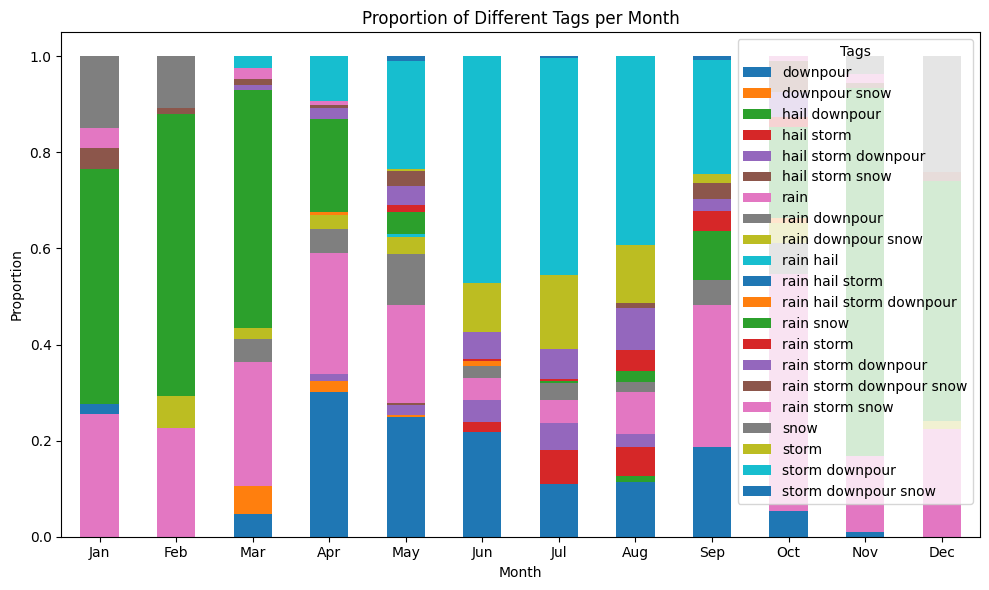

In [62]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV data into a pandas DataFrame
df = pd.read_csv('/home/ubuntu/data/TAASRAD19/hdf_metadata.csv')

# Convert the start_datetime column to datetime
df['start_datetime'] = pd.to_datetime(df['start_datetime'])

# Extract month from start_datetime
df['month'] = df['start_datetime'].dt.month

# Compute tag frequencies by month
tag_freq_by_month = df.groupby(['month', 'tags']).size().unstack(fill_value=0)

# Convert to proportions
tag_props_by_month = tag_freq_by_month.div(tag_freq_by_month.sum(axis=1), axis=0)

# Plot
tag_props_by_month.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Proportion of Different Tags per Month')
plt.xlabel('Month')
plt.ylabel('Proportion')
plt.xticks(range(0, 12), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=0)
plt.legend(title='Tags')
plt.tight_layout()
plt.show()
